In [2]:
import os
import shutil  # For copying files
import glob    # For finding all the .jpg and .png files
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import time
from pycocotools.coco import COCO
import skimage.io as io
from skimage.color import rgb2gray
from tqdm.notebook import tqdm # For a nice progress bar

print(f"TensorFlow Version: {tf.__version__}")

TensorFlow Version: 2.18.0


In [3]:
NUM_IMAGES_TO_PROCESS = 20000
NUM_DISPLAY_VALIDATION = 50  
NUM_DISPLAY_AUGMENTED = 20
BATCH_SIZE = 32


DATA_ROOT = "/kaggle/working/segmentation_data"
IMAGE_DIR = os.path.join(DATA_ROOT, "images")
MASK_DIR = os.path.join(DATA_ROOT, "masks")

dataType = 'train2017'
dataDir = '/kaggle/input/coco-2017-dataset/coco2017'
img_dir_original = os.path.join(dataDir, dataType)
annFile = os.path.join(dataDir, 'annotations', f'instances_{dataType}.json')


print("Loading annotations...")
coco = COCO(annFile)
print("Annotations loaded.")

all_imgIds = coco.getImgIds()
print(f"Total images in {dataType}: {len(all_imgIds)}")

imgIds_subset = all_imgIds[:NUM_IMAGES_TO_PROCESS]
print(f"Will process: {len(imgIds_subset)} images.")

Loading annotations...
loading annotations into memory...
Done (t=20.16s)
creating index...
index created!
Annotations loaded.
Total images in train2017: 118287
Will process: 20000 images.


In [4]:
print(f"Creating directories...")
os.makedirs(IMAGE_DIR, exist_ok=True)
os.makedirs(MASK_DIR, exist_ok=True)

print(f"Starting to generate {len(imgIds_subset)} image/mask pairs...")
print(f"Images will be saved to: {IMAGE_DIR}")
print(f"Masks will be saved to: {MASK_DIR}")

skipped_grayscale = 0
skipped_no_anns = 0
skipped_empty_mask = 0

for imgId in tqdm(imgIds_subset):
    
    img_info = coco.loadImgs(imgId)[0]
    file_name = img_info['file_name'] # e.g., '000000123456.jpg'
    
    source_img_path = os.path.join(img_dir_original, file_name)
    dest_img_path = os.path.join(IMAGE_DIR, file_name)
    
    # Save masks as PNG
    mask_file_name = os.path.splitext(file_name)[0] + ".png"
    dest_mask_path = os.path.join(MASK_DIR, mask_file_name)
    
    # --- 2. Check if files already exist ---
    if os.path.exists(dest_img_path) and os.path.exists(dest_mask_path):
        continue
        
    # --- 3. Check for annotations ---
    annIds = coco.getAnnIds(imgIds=img_info['id'])
    anns = coco.loadAnns(annIds)
    if not anns:
        skipped_no_anns += 1
        continue
        
    # --- 4. Load Image ---
    I = io.imread(source_img_path)
    
    # --- 5. Skip Grayscale Images ---
    if I.ndim == 2:
        skipped_grayscale += 1
        continue
        
    # --- 6. Generate Combined Binary Mask ---
    final_binary_mask = np.zeros((I.shape[0], I.shape[1]), dtype=np.uint8)
    
    for ann in anns:
        mask = coco.annToMask(ann)
        final_binary_mask = np.logical_or(final_binary_mask, mask)
        
    if final_binary_mask.sum() == 0:
        skipped_empty_mask += 1
        continue
        
    # --- 7. Save Both Files ---
    shutil.copyfile(source_img_path, dest_img_path)
    
    final_mask_image = (final_binary_mask * 255).astype(np.uint8)
    io.imsave(dest_mask_path, final_mask_image)

print("\n--- Data Generation Complete ---")
print(f"Skipped {skipped_grayscale} grayscale images.")
print(f"Skipped {skipped_no_anns} images with no annotations.")
print(f"Skipped {skipped_empty_mask} images with empty masks.")

Creating directories...
Starting to generate 20000 image/mask pairs...
Images will be saved to: /kaggle/working/segmentation_data/images
Masks will be saved to: /kaggle/working/segmentation_data/masks


  0%|          | 0/20000 [00:00<?, ?it/s]


--- Data Generation Complete ---
Skipped 37 grayscale images.
Skipped 170 images with no annotations.
Skipped 0 images with empty masks.



--- Task 1b: Validating Generated Data (Displaying 50 pairs) ---
Loading 50 image/mask pairs from generated folders...


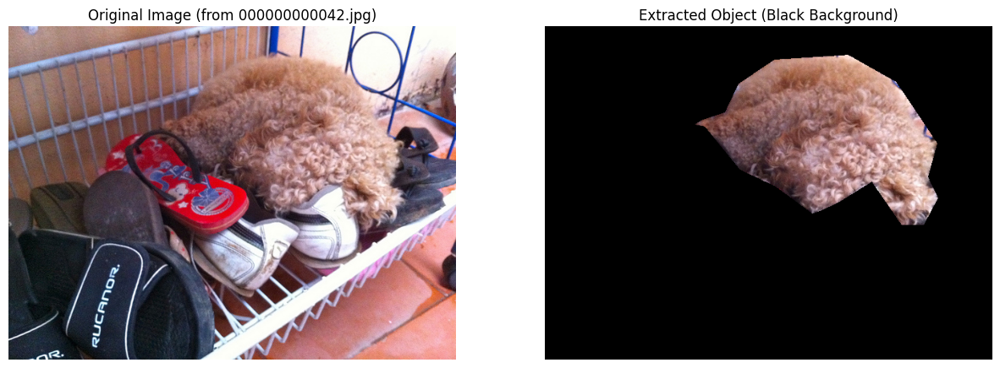

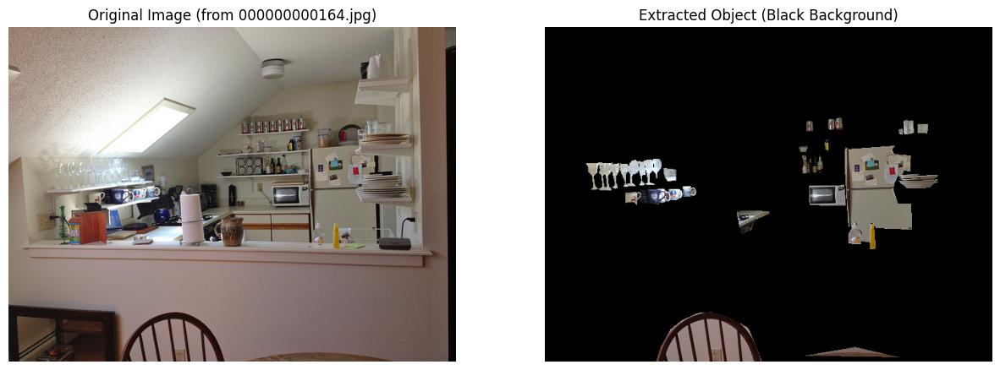

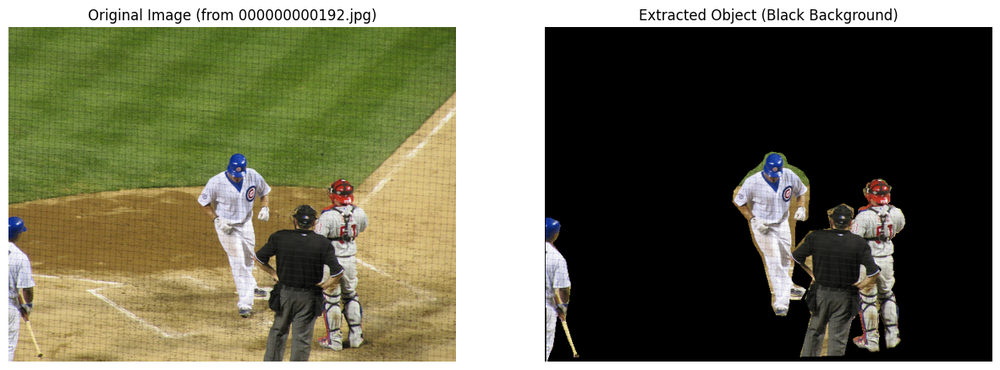

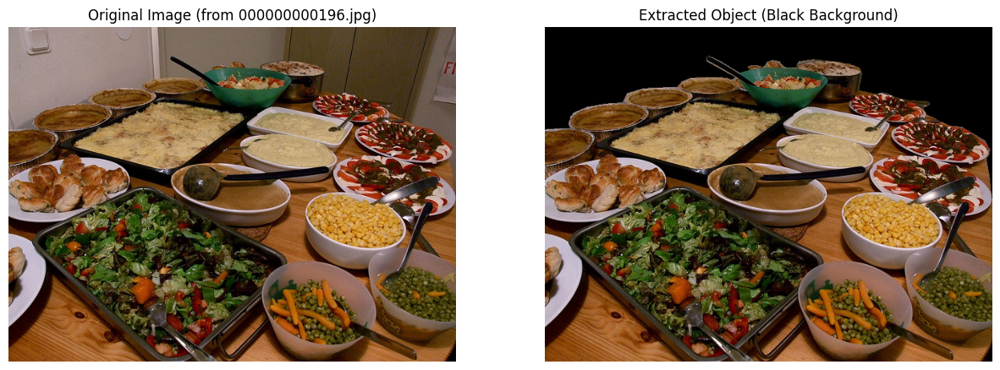

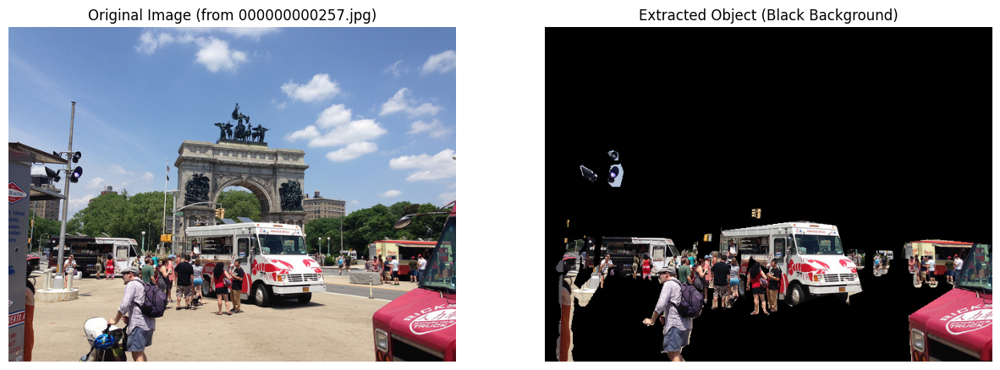

...

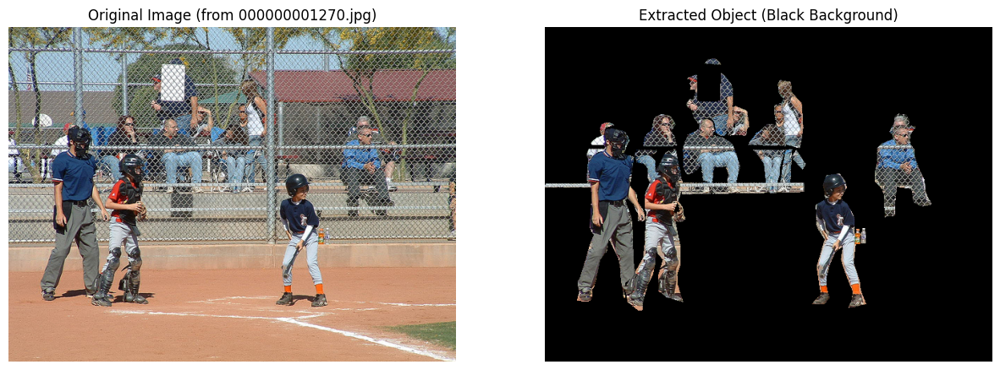

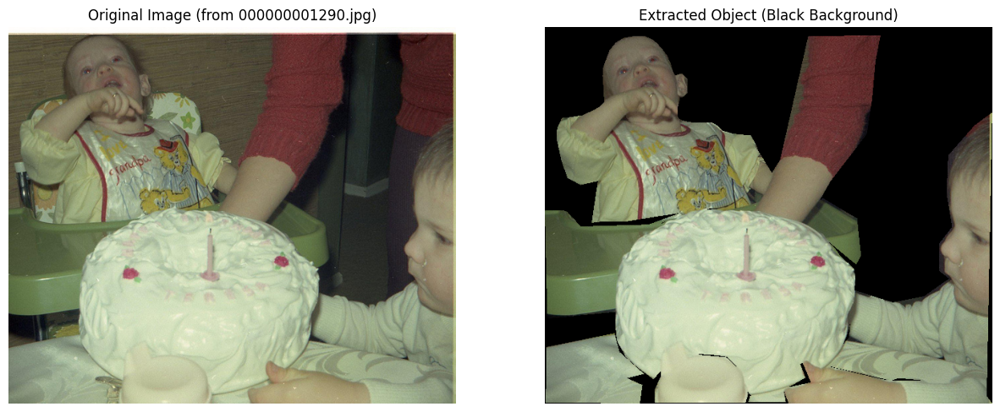

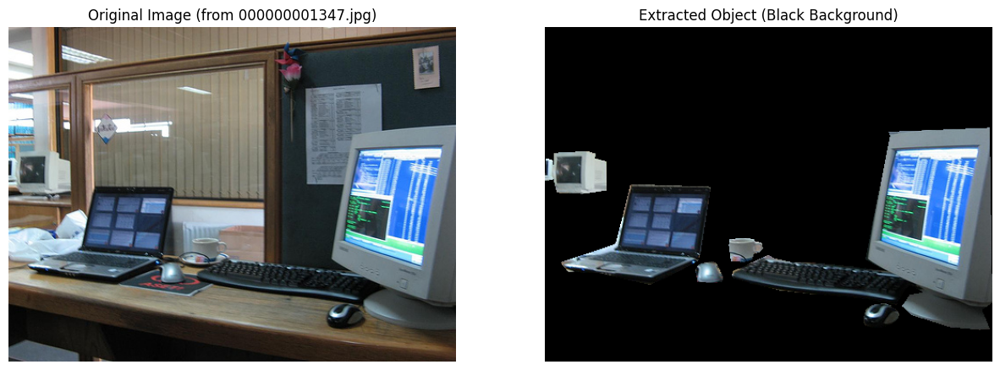

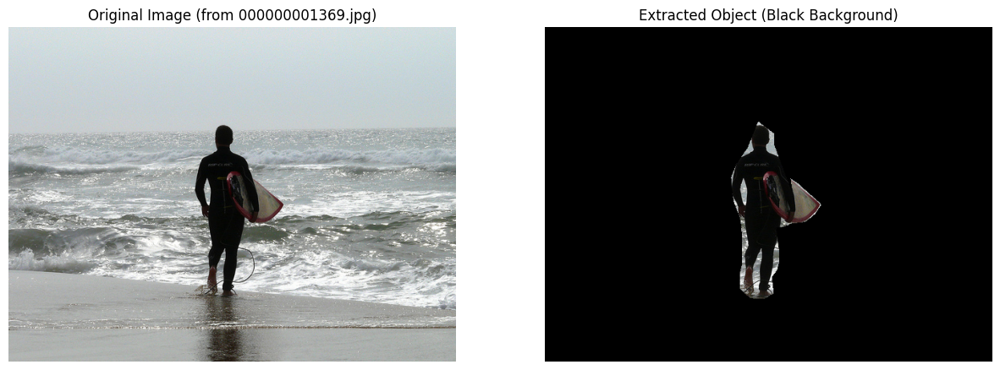

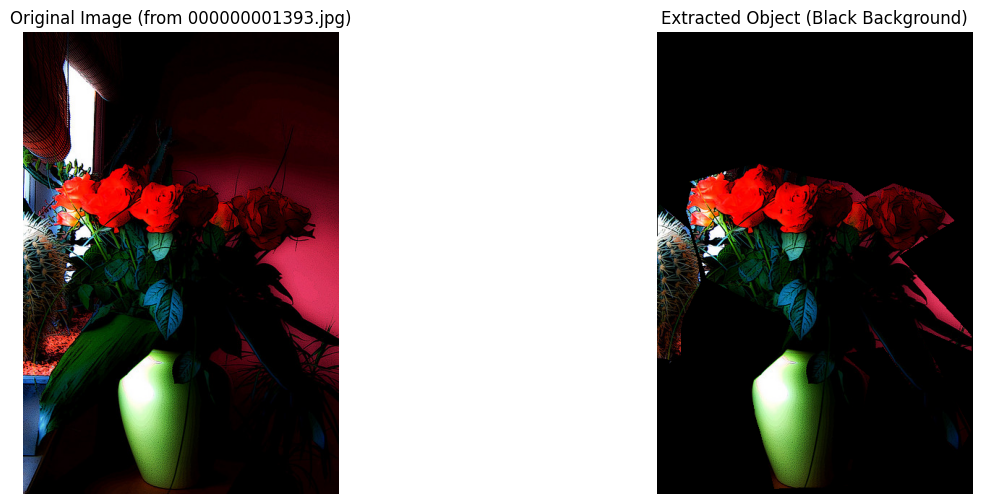

--- Validation Display Complete ---


In [5]:
print(f"\n--- Task 1b: Validating Generated Data (Displaying {NUM_DISPLAY_VALIDATION} pairs) ---")

# Get the lists of files you just created
validation_image_paths = sorted(glob.glob(os.path.join(IMAGE_DIR, "*.jpg")))
validation_mask_paths = sorted(glob.glob(os.path.join(MASK_DIR, "*.png")))

if not validation_image_paths:
    print("Error: No images found in {IMAGE_DIR}. Cannot validate.")
else:
    print(f"Loading {NUM_DISPLAY_VALIDATION} image/mask pairs from generated folders...")
    
    # Loop and display 50 pairs
    for i in range(NUM_DISPLAY_VALIDATION):
        # Safety check
        if i >= len(validation_image_paths):
            print("Reached end of generated images.")
            break
            
        # Get the file paths
        img_path = validation_image_paths[i]
        mask_path = validation_mask_paths[i]
        
        # Read the images from disk
        original_img = io.imread(img_path)
        mask_img = io.imread(mask_path)
        
        # Create Object-on-Black-Background Image ---
        # Ensure mask_img is binary (0 or 1)
        # It's currently 0 or 255 because of how it was saved, so divide by 255.
        binary_mask = (mask_img > 0).astype(original_img.dtype) # Cast to same dtype as image
        
        # Create a black background image of the same size as the original
        object_on_black_bg = np.zeros_like(original_img)
        
        # Apply the mask: where the mask is 1, copy pixels from the original image
        # We need to handle 3 channels for color images.
        # np.where works well here: if mask is 1, take original pixel, else take 0 (black)
        object_on_black_bg = np.where(binary_mask[..., np.newaxis], original_img, 0)
        # np.newaxis adds a channel dimension to the mask (e.g., (H,W) -> (H,W,1))
        # so it can broadcast correctly with the 3-channel image.
        
        # --- Plot ---
        fig, ax = plt.subplots(1, 2, figsize=(15, 6))
        
        ax[0].imshow(original_img)
        ax[0].set_title(f'Original Image (from {os.path.basename(img_path)})')
        ax[0].axis('off')
        
        # Display the object with black background
        ax[1].imshow(object_on_black_bg) 
        ax[1].set_title(f'Extracted Object (Black Background)')
        ax[1].axis('off')
        
        plt.show()

print("--- Validation Display Complete ---")

In [6]:
print(f"\n--- Task 2 (Part A): Building the (Image, Mask) Pipeline ---")

IMG_HEIGHT = 256
IMG_WIDTH = 256
# Get all file paths
image_paths = sorted(glob.glob(os.path.join(IMAGE_DIR, "*.jpg")))
mask_paths = sorted(glob.glob(os.path.join(MASK_DIR, "*.png")))

print(f"Found {len(image_paths)} images for the pipeline.")
print(f"Found {len(mask_paths)} masks for the pipeline.")

if not image_paths or not mask_paths:
     print("Error: Cannot build pipeline. Data folders are empty.")
else:
    # --- 2. Create the Dataset of file paths ---
    path_ds = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))

    # --- 3. Define Pipeline Functions (WITH CORRECTION) ---
    def load_and_preprocess(image_path, mask_path):
        # Load Image
        img = tf.io.read_file(image_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [IMG_HEIGHT, IMG_WIDTH])
        img = tf.cast(img, tf.float32) / 255.0 # Cast before dividing

        # Load Mask
        mask = tf.io.read_file(mask_path)
        mask = tf.image.decode_png(mask, channels=1)
        mask = tf.image.resize(mask, [IMG_HEIGHT, IMG_WIDTH], method='nearest')
        mask = tf.cast(mask, tf.float32) / 255.0 # Cast before dividing
        
        return img, mask

    def augment_pair(image, mask):
        if tf.random.uniform(()) > 0.5:
            image = tf.image.flip_left_right(image)
            mask = tf.image.flip_left_right(mask)
        return image, mask

    # --- 4. Build the Full Pipeline ---
    AUTOTUNE = tf.data.AUTOTUNE
    
    # Create the base dataset of processed images/masks
    ds = path_ds.map(load_and_preprocess, num_parallel_calls=AUTOTUNE)

    # --- Create datasets for display ---
    # 1. 'ds_processed': The dataset *before* augmentation. We cache it for speed.
    ds_processed = ds.cache() 
    # 2. 'ds_augmented': The dataset *after* augmentation.
    ds_augmented = ds_processed.map(augment_pair, num_parallel_calls=AUTOTUNE)

    # --- Create the final pipeline for *training* ---
    # This pipeline includes shuffling, augmentation, batching, and prefetching
    ds_pipeline = (
        ds
        .cache()
        .shuffle(len(image_paths))
        .map(augment_pair, num_parallel_calls=AUTOTUNE)
        .batch(BATCH_SIZE)
        .prefetch(AUTOTUNE)
    )

    print("\nPipeline created successfully.")
    for img_batch, mask_batch in ds_pipeline.take(1):
        print(f"Image batch shape: {img_batch.shape}")
        print(f"Mask batch shape:  {mask_batch.shape}")


--- Task 2 (Part A): Building the (Image, Mask) Pipeline ---
Found 19793 images for the pipeline.
Found 19793 masks for the pipeline.


I0000 00:00:1761831131.776595     169 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0



Pipeline created successfully.
Image batch shape: (32, 256, 256, 3)
Mask batch shape:  (32, 256, 256, 1)



--- Task 2 (Part B): Displaying 20 Original vs. Augmented Images ---
Showing 20 side-by-side image comparisons...


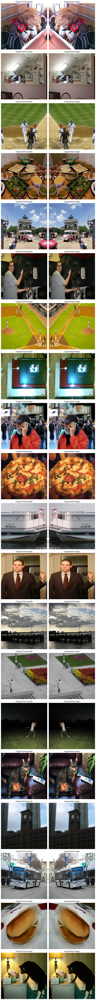


All tasks complete


In [7]:
print(f"\n--- Task 2 (Part B): Displaying {NUM_DISPLAY_AUGMENTED} Original vs. Augmented Images ---")

if 'ds_processed' not in locals() or 'ds_augmented' not in locals():
    print("Error: Display pipelines were not created in Cell 5.")
else:
    # Zip the 'before' and 'after' datasets together
    display_ds = tf.data.Dataset.zip((ds_processed, ds_augmented))
    
    # Create a figure with 2 columns
    plt.figure(figsize=(10, NUM_DISPLAY_AUGMENTED * 5)) # Changed figsize to 10
    
    print(f"Showing {NUM_DISPLAY_AUGMENTED} side-by-side image comparisons...")
    
    # Unpack the zipped dataset
    # We still get the masks, but we will just ignore them
    for i, ((original_image, _), (augmented_image, _)) in enumerate(display_ds.take(NUM_DISPLAY_AUGMENTED)):
        
        # Plot 1: Original Processed Image (Resized + Normalized)
        # Use 2 columns in subplot
        ax = plt.subplot(NUM_DISPLAY_AUGMENTED, 2, i * 2 + 1) 
        ax.imshow(tf.clip_by_value(original_image, 0.0, 1.0))
        ax.set_title("Original (Processed)")
        ax.axis("off")

        # Plot 2: Augmented Image
        # Use 2 columns in subplot
        ax = plt.subplot(NUM_DISPLAY_AUGMENTED, 2, i * 2 + 2) 
        ax.imshow(tf.clip_by_value(augmented_image, 0.0, 1.0))
        ax.set_title("Augmented Image")
        ax.axis("off")

    

    plt.tight_layout()
    plt.show()

print("\nAll tasks complete")